Casual Inference

In [1]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt 
import seaborn as sns
from math import log, exp
from scipy.stats import norm, skew 
import scipy.stats as stats

In [2]:
abspath = '/home/semipro321/Documents/Workspace/Geospatial-Analysis-on-House-Price-Prediction/'
df = pd.read_csv(abspath + 'Inputs/mastermodel_filledv2.csv')
df.shape
quantitative = [f for f in df.columns if df.dtypes[f] != 'object']
quantitative.remove('final_price')

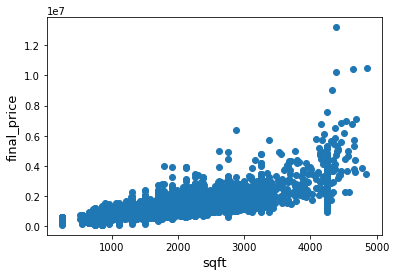

In [3]:
fig, ax = plt.subplots()
ax.scatter(x = df['sqft'], y = df['final_price'])
plt.ylabel('final_price', fontsize=13)
plt.xlabel('sqft', fontsize=13)
plt.show()

Few Outliers gotta fix that

In [5]:
neighdumcol = [col for col in df.columns if 'neighbourhood' in col]
typedumcol = [col for col in df.columns if 'type' in col]
dumcol = neighdumcol + typedumcol

In [6]:
dfnotdum = df.drop(columns=dumcol)
dfnotdum.describe()

,sqft,parking,mean_district_income,bedrooms_bg,bedrooms_ag,bathrooms,final_price,dist_nearest_school,dist_nearest_ttc,Airbnb_500m,Airbnb_1000m,Auto Theft500m,Auto Theft1000m,violent_crime1000m,violent_crime500m
count,15234.000000,15234.000000,15234.000000,15234.000000,15234.000000,15234.000000,1.523400e+04,15234.000000,15234.000000,15234.000000,15234.000000,15234.000000,15234.00000,15234.000000,15234.000000
mean,1313.590129,1.559144,56065.642576,0.539583,2.335500,2.122227,8.827136e+05,434.982201,2116.654001,178.711435,375.271957,38.311868,90.68695,1488.931403,613.329723
std,749.598473,1.345642,32547.705435,0.667572,1.136062,1.128122,6.189336e+05,561.112155,1361.497816,323.288805,647.303462,27.971358,56.54868,1841.810643,785.506156
min,250.000000,0.000000,25989.000000,0.000000,0.000000,1.000000,1.030000e+05,10.432917,18.820857,0.000000,0.000000,0.000000,2.00000,35.000000,8.000000
25%,750.000000,1.000000,34904.000000,0.000000,1.000000,1.000000,5.350000e+05,207.280478,1100.399221,12.000000,29.000000,18.000000,52.00000,452.000000,174.000000
50%,1110.243286,1.000000,50580.000000,0.000000,2.000000,2.000000,7.150000e+05,318.440743,1869.255543,34.000000,77.000000,30.000000,76.00000,744.000000,307.000000
75%,1666.566681,2.000000,67757.000000,1.000000,3.000000,3.000000,9.890000e+05,488.439532,2899.707018,172.000000,326.000000,51.000000,114.00000,1521.000000,657.750000
max,4852.187012,11.000000,308010.000000,6.000000,9.000000,14.000000,1.318000e+07,6904.513193,8775.156855,1776.000000,3494.000000,162.000000,383.00000,11911.000000,5165.000000


It is apparent that final_price doesn't follow normal distribution, so before performing regression it has to be transformed. While log transformation does pretty good job, best fit is unbounded Johnson distribution.


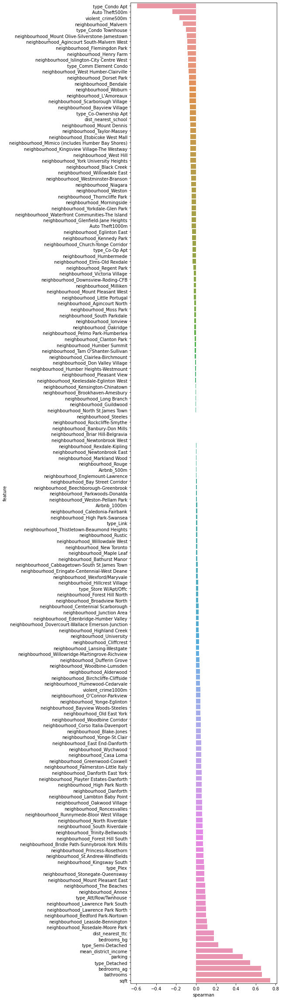

In [7]:
def spearman(frame, features):
    spr = pd.DataFrame()
    spr['feature'] = features
    spr['spearman'] = [frame[f].corr(frame['final_price'], 'spearman') for f in features]
    spr = spr.sort_values('spearman')
    plt.figure(figsize=(6, 0.25*len(features)))
    sns.barplot(data=spr, y='feature', x='spearman', orient='h')
    
features = df.drop('final_price',axis=1).columns
spearman(df, features)

In [8]:
log_col = ['sqft','mean_district_income','final_price','dist_nearest_school', 'dist_nearest_ttc']


 mu = 1313.59 and sigma = 749.57

/home/semipro321/anaconda3/envs/dataenv/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


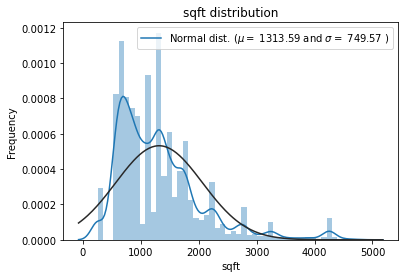

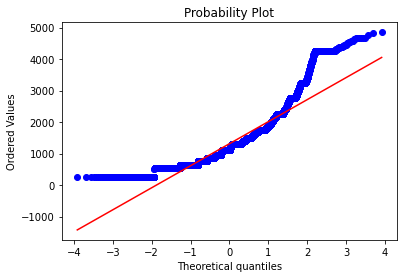

/home/semipro321/anaconda3/envs/dataenv/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)

 mu = 56065.64 and sigma = 32546.64



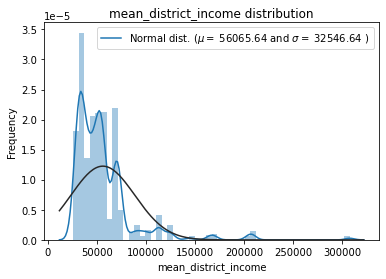

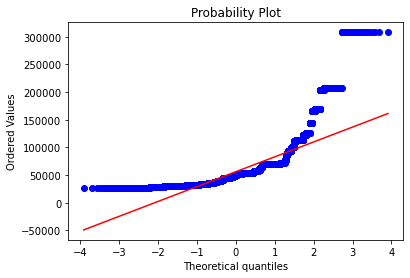

/home/semipro321/anaconda3/envs/dataenv/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)

 mu = 882713.62 and sigma = 618913.28



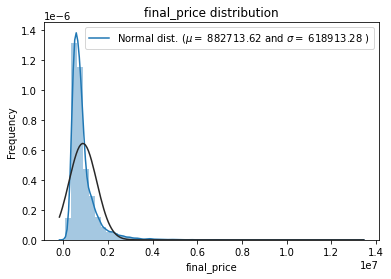

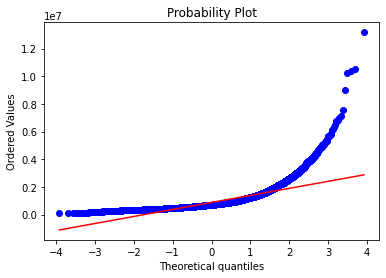

/home/semipro321/anaconda3/envs/dataenv/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)

 mu = 434.98 and sigma = 561.09



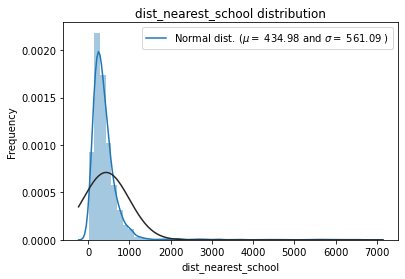

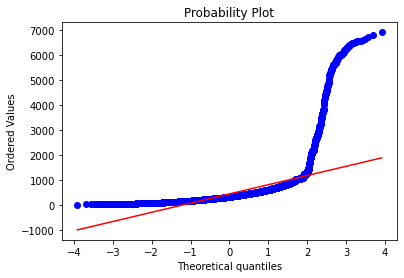

/home/semipro321/anaconda3/envs/dataenv/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)

 mu = 2116.65 and sigma = 1361.45



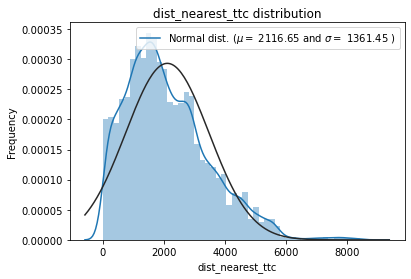

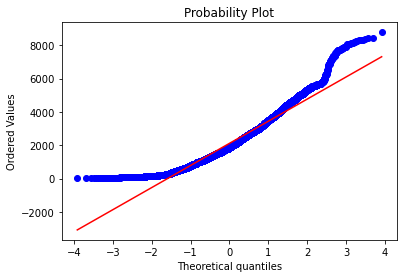

In [9]:
for i in log_col:
    sns.distplot(df[i] , fit=norm);

    # Get the fitted parameters used by the function
    (mu, sigma) = norm.fit(df[i])
    print( '\n mu = {:.2f} and sigma = {:.2f}\n'.format(mu, sigma))

    #Now plot the distribution
    plt.legend(['Normal dist. ($\mu=$ {:.2f} and $\sigma=$ {:.2f} )'.format(mu, sigma)],
                loc='best')
    plt.ylabel('Frequency')
    plt.title(f'{i} distribution')

    #Get also the QQ-plot
    fig = plt.figure()
    res = stats.probplot(df[i], plot=plt)
    plt.show()



 mu = 7.04 and sigma = 0.55

/home/semipro321/anaconda3/envs/dataenv/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


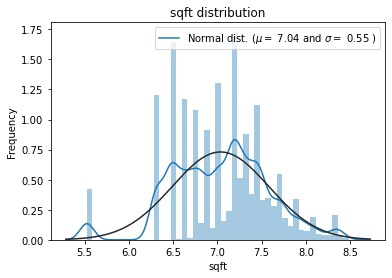

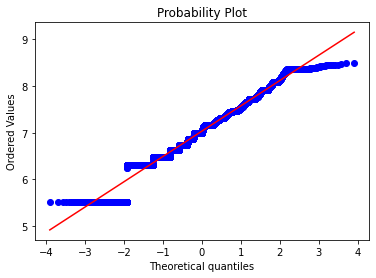

/home/semipro321/anaconda3/envs/dataenv/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)

 mu = 10.83 and sigma = 0.42



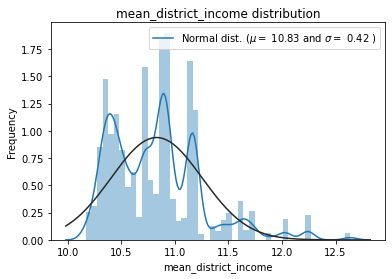

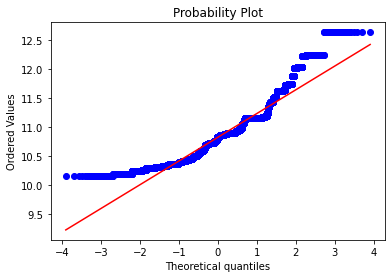

/home/semipro321/anaconda3/envs/dataenv/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)

 mu = 13.54 and sigma = 0.51



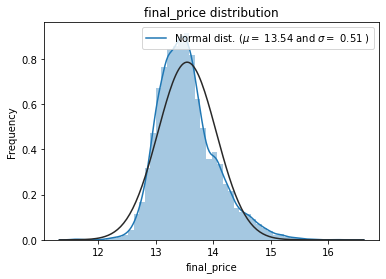

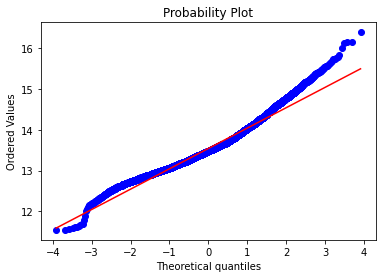

/home/semipro321/anaconda3/envs/dataenv/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)

 mu = 5.77 and sigma = 0.73



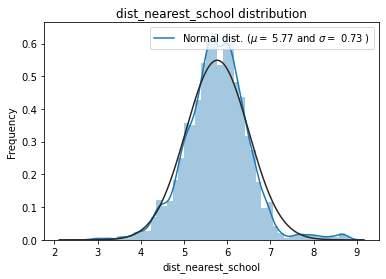

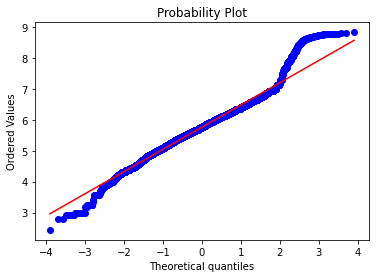

/home/semipro321/anaconda3/envs/dataenv/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)

 mu = 7.39 and sigma = 0.85



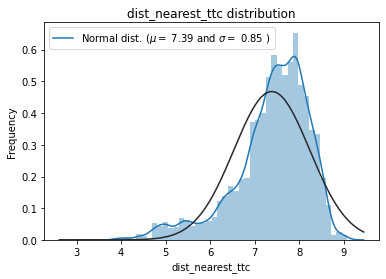

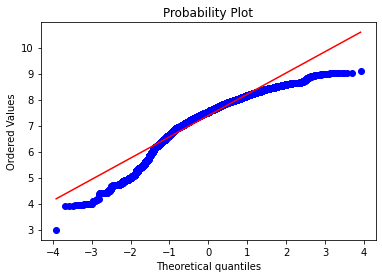

In [10]:
for i in log_col:
    #We use the numpy fuction log1p which  applies log(1+x) to all elements of the column
    df[i] = np.log1p(df[i])

    #Check the new distribution 
    sns.distplot(df[i] , fit=norm);

    # Get the fitted parameters used by the function
    (mu, sigma) = norm.fit(df[i])
    print( '\n mu = {:.2f} and sigma = {:.2f}\n'.format(mu, sigma))

    #Now plot the distribution
    plt.legend(['Normal dist. ($\mu=$ {:.2f} and $\sigma=$ {:.2f} )'.format(mu, sigma)],
                loc='best')
    plt.ylabel('Frequency')
    plt.title(f'{i} distribution')

    #Get also the QQ-plot
    fig = plt.figure()
    res = stats.probplot(df[i], plot=plt)
    plt.show()

In [11]:
from sklearn.model_selection import train_test_split
X =df.drop('final_price', axis=1)
y = df['final_price']

X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.3,random_state=23)

In [12]:
from sklearn.linear_model import LinearRegression 

reg = LinearRegression().fit(X_train, y_train)
reg.score(X_train,y_train)

0.8943068989496621

In [13]:
# The parameters for linear regression model
X_0 = np.c_[np.ones((X_train.shape[0],1)),X_train]
parameter = ['theta_'+str(i) for i in range(X_0.shape[1])]
columns = ['intersect:x_0=1'] + list(X.columns.values)
parameter_df = pd.DataFrame({'Parameter':parameter,'Columns':columns})

In [14]:
sk_theta = [reg.intercept_]+list(reg.coef_)
parameter_df = parameter_df.join(pd.Series(sk_theta, name='Sklearn_theta'))
parameter_df

,Parameter,Columns,Sklearn_theta
0,theta_0,intersect:x_0=1,1.840630e+08
1,theta_1,sqft,4.643891e-01
2,theta_2,parking,2.789481e-02
3,theta_3,mean_district_income,-1.461530e+07
4,theta_4,bedrooms_bg,-4.569738e-03
...,...,...,...
161,theta_161,neighbourhood_Yorkdale-Glen Park,-3.252881e+06
162,theta_162,Auto Theft500m,-3.842488e-04
163,theta_163,Auto Theft1000m,-2.492033e-04
164,theta_164,violent_crime1000m,-6.150454e-06


In [16]:
y_pred = reg.predict(X_test)
#Evaluvation: MSE
from sklearn.metrics import mean_squared_error
mse = mean_squared_error(y_pred, y_test)

# R_square
R_square = reg.score(X_test,y_test)
print('The Mean Square Error(MSE) or J(theta) is: ',mse)
print('R square obtain for scikit learn library is :',R_square)

The Mean Square Error(MSE) or J(theta) is:  0.029341333105273894
R square obtain for scikit learn library is : 0.8862097148753423


/home/semipro321/anaconda3/envs/dataenv/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/home/semipro321/anaconda3/envs/dataenv/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


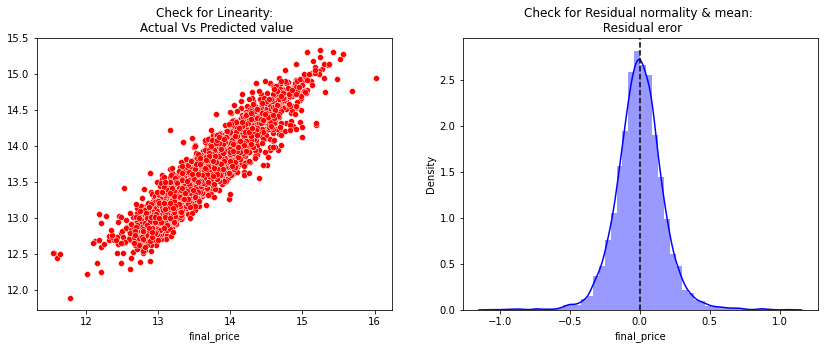

In [19]:
# Check for Linearity
f = plt.figure(figsize=(14,5))
ax = f.add_subplot(121)
sns.scatterplot(y_test,y_pred,ax=ax,color='r')
ax.set_title('Check for Linearity:\n Actual Vs Predicted value')

# Check for Residual normality & mean
ax = f.add_subplot(122)
sns.distplot((y_test - y_pred),ax=ax,color='b')
ax.axvline((y_test - y_pred).mean(),color='k',linestyle='--')
ax.set_title('Check for Residual normality & mean: \n Residual eror');

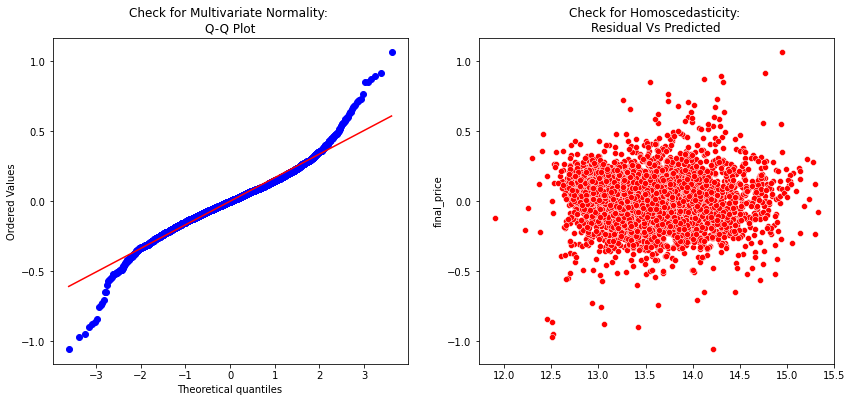

In [22]:
# Check for Multivariate Normality
# Quantile-Quantile plot 
f,ax = plt.subplots(1,2,figsize=(14,6))
import scipy as sp
_,(_,_,r)= sp.stats.probplot((y_test - y_pred),fit=True,plot=ax[0])
ax[0].set_title('Check for Multivariate Normality: \nQ-Q Plot')

#Check for Homoscedasticity
sns.scatterplot(y = (y_test - y_pred), x= y_pred, ax = ax[1],color='r') 
ax[1].set_title('Check for Homoscedasticity: \nResidual Vs Predicted');

In [24]:
# Check for Multicollinearity
#Variance Inflation Factor
VIF = 1/(1- R_square)
VIF

8.788096443422177

The model assumption linear regression as follows

1. In our model the actual vs predicted plot is straight so linear assumption true  

2. The residual mean is zero and residual error plot is normal. So normality is good

3. Q-Q plot shows as value log value greater than 2 trends to increase  

4. The plot is exhibit heteroscedastic, error will insease after certian point.  

5. Variance inflation factor value is more than 5, so multicollearity but still under 10 so its ok.

In [26]:
import statsmodels.api as sm
ols = sm.OLS(y,X)
fii = ols.fit()

In [28]:
print(fii.summary())

                            OLS Regression Results                            
Dep. Variable:            final_price   R-squared:                       0.892
Model:                            OLS   Adj. R-squared:                  0.891
Method:                 Least Squares   F-statistic:                     770.8
Date:                Mon, 08 Mar 2021   Prob (F-statistic):               0.00
Time:                        23:38:03   Log-Likelihood:                 5680.7
No. Observations:               15234   AIC:                        -1.104e+04
Df Residuals:                   15071   BIC:                            -9791.
Df Model:                         162                                         
Covariance Type:            nonrobust                                         
                                                        coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------

In [29]:
df['sqft'].head()

0    6.746412
1    7.167284
2    6.311735
3    6.478510
4    6.885698
Name: sqft, dtype: float64

Airbnb had almost no effect
